DOWNLOADING TACO DATASET

In [1]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="Loig29AVI7Di9gzF3cfB")
project = rf.workspace("gobi-z2agt").project("taco-to-yolo-final-n1pmj")
version = project.version(1)
dataset = version.download("yolov11")
                

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.4/85.4 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 30.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 66.1 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.11.0.86
    Uninstalling opencv-python-headless-4.11.0.86:
      Successfully uninstalled opencv-python-headless-4.11.0.86
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
sigstore 3.6.1 requires rich~=13.0, but you have rich 14.0.0 which is incompatible.
datasets 3.5.0 requires fsspec[http]<=2024.12.0,>=2023.1.0, 


Extracting Dataset Version Zip to Taco-to-Yolo-Final-1 in yolov11:: 100%|██████████| 3010/3010 [00:00<00:00, 3765.42it/s]


DOWNLOADING CUSTOM DATASET

In [2]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="Loig29AVI7Di9gzF3cfB")
project = rf.workspace("gobi-z2agt").project("taco_extra")
version = project.version(1)
dataset = version.download("yolov11")
                

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to TACO_extra-1 in yolov11:: 100%|██████████| 634/634 [00:00<00:00, 4567.00it/s]


COPY FUNCTION

In [3]:
import os
import shutil

def copy_all_files(src, dst):
    # Create destination directory if it doesn't exist
    os.makedirs(dst, exist_ok=True)

    for filename in os.listdir(src):
        src_file = os.path.join(src, filename)
        dst_file = os.path.join(dst, filename)

        
        # Skip if file already exists in destination
        if os.path.exists(dst_file):
            continue

        if os.path.isfile(src_file):
            shutil.copy2(src_file, dst_file)  # copy2 preserves metadata
            print(f"Copied: {src_file} -> {dst_file}")

CREATING LABEL MAPS

In [4]:
# taco_original (index-based labels)
taco_original = ['Aerosol', 'Aluminium blister pack', 'Aluminium foil', 'Battery', 'Broken glass',
    'Carded blister pack', 'Cigarette', 'Clear plastic bottle', 'Corrugated carton', 'Crisp packet',
    'Disposable food container', 'Disposable plastic cup', 'Drink can', 'Drink carton', 'Egg carton',
    'Foam cup', 'Foam food container', 'Food Can', 'Food waste', 'Garbage bag', 'Glass bottle',
    'Glass cup', 'Glass jar', 'Magazine paper', 'Meal carton', 'Metal bottle cap', 'Metal lid',
    'Normal paper', 'Other carton', 'Other plastic', 'Other plastic bottle', 'Other plastic container',
    'Other plastic cup', 'Other plastic wrapper', 'Paper bag', 'Paper cup', 'Paper straw', 'Pizza box',
    'Plastic bottle cap', 'Plastic film', 'Plastic glooves', 'Plastic lid', 'Plastic straw',
    'Plastic utensils', 'Polypropylene bag', 'Pop tab', 'Rope - strings', 'Scrap metal', 'Shoe',
    'Single-use carrier bag', 'Six pack rings', 'Spread tub', 'Squeezable tube', 'Styrofoam piece',
    'Tissues', 'Toilet tube', 'Tupperware', 'Unlabeled litter', 'Wrapping paper']

# taco_extra (index-based labels)
taco_extra = ['Aerosol', 'Aluminium blister pack', 'Aluminium foil', 'Battery', 'Cigarette',
    'Clear plastic bottle', 'Crisp packet', 'Disposable food container', 'Disposable plastic cup',
    'Drink can', 'Foam cup', 'Food waste', 'Garbage bag', 'Glass bottle', 'Glass cup', 'Meal carton',
    'Metal bottle cap', 'Normal paper', 'Other carton', 'Other plastic', 'Other plastic bottle',
    'Other plastic container', 'Other plastic cup', 'Other plastic wrapper', 'Paper Bag', 'Paper bag',
    'Paper cup', 'Paper straw', 'Plastic bottle cap', 'Plastic film', 'Plastic glooves', 'Plastic lid',
    'Plastic straw', 'Plastic utensils', 'Pop tab', 'Single-use carrier bag', 'Spread tub',
    'Squeezable tube', 'Tissues', 'Toilet tube', 'Unlabeled litter', 'Wrapping paper', 'general_waste',
    'glass', 'metal', 'organic_waste', 'paper', 'plastic']


In [5]:
print(len(taco_original))

59


In [6]:
print(len(taco_extra))

48


In [7]:
# Consolidated mapping dictionary as built before
consolidated_lookup = {
    'Cigarette': 0,
    'Plastic bottle': 1,
    'Plastic wrapper': 2,
    'Plastic container': 3,
    'Plastic cup': 4,
    'Plastic lid/cap': 5,
    'Plastic utensil': 6,
    'Plastic straw': 7,
    'Plastic bag': 8,
    'Plastic gloves': 9,
    'Foam container': 10,
    'Paper straw': 11,
    'Paper': 12,
    'Paper container': 13,
    'Carton': 14,
    'Metal can/lid': 15,
    'Scrap metal': 16,
    'Glass': 17,
    'Aluminium/foil': 18,
    'Rope/string': 19,
    'Aerosol': 20,
    'Tissues': 21,
    'Unlabeled litter': 22,
    'Food waste': 23,
    'Other': 24,
    
    # Ignored
    'Six pack rings': -1,
    'Shoe': -1,
    'Battery': -1,
    'Blister pack': -1,
}

# Inverse mapping: class name (from original/extra) → consolidated group name
class_to_group = {}
for group, items in {
    'Cigarette': ['Cigarette'],
    'Plastic bottle': ['Clear plastic bottle', 'Other plastic bottle'],
    'Plastic wrapper': ['Plastic film', 'Other plastic wrapper', 'Crisp packet'],
    'Plastic container': ['Disposable food container', 'Other plastic container', 'Spread tub', 'Squeezable tube', 'Tupperware'],
    'Plastic cup': ['Disposable plastic cup', 'Other plastic cup'],
    'Plastic lid/cap': ['Plastic bottle cap', 'Plastic lid'],
    'Plastic utensil': ['Plastic utensils'],
    'Plastic straw': ['Plastic straw'],
    'Plastic bag': ['Garbage bag', 'Polypropylene bag', 'Single-use carrier bag'],
    'Plastic gloves': ['Plastic glooves'],
    'Foam container': ['Foam cup', 'Foam food container', 'Styrofoam piece'],
    'Paper straw': ['Paper straw'],
    'Paper': ['Normal paper', 'Magazine paper', 'Wrapping paper', 'paper', 'Paper Bag', 'Paper bag'],
    'Paper container': ['Paper cup', 'Paper bag', 'Pizza box', 'Toilet tube', 'Egg carton'],
    'Carton': ['Drink carton', 'Meal carton', 'Other carton', 'Corrugated carton'],
    'Metal can/lid': ['Drink can', 'Food Can', 'Metal bottle cap', 'Metal lid', 'Pop tab'],
    'Scrap metal': ['Scrap metal', 'metal'],
    'Glass': ['Glass bottle', 'Glass jar', 'Glass cup', 'Broken glass', 'glass'],
    'Aluminium/foil': ['Aluminium blister pack', 'Aluminium foil'],
    'Battery': ['Battery'],
    'Rope/string': ['Rope - strings'],
    'Shoe': ['Shoe'],
    'Blister pack': ['Carded blister pack', 'Aluminium blister pack'],
    'Aerosol': ['Aerosol'],
    'Tissues': ['Tissues'],
    'Unlabeled litter': ['Unlabeled litter'],
    'Food waste': ['Food waste', 'organic_waste'],
    'Six pack rings': ['Six pack rings'],
    'Other': ['Other plastic', 'general_waste'],
}.items():
    for item in items:
        class_to_group[item] = group

# Build label maps
taco_original_label_map = {
    idx: consolidated_lookup.get(class_to_group.get(name, 'Other'), -1)
    for idx, name in enumerate(taco_original)
}


taco_extra_label_map = {
    idx: consolidated_lookup.get(class_to_group.get(name, 'Other'), -1)
    for idx, name in enumerate(taco_extra)
}


In [8]:
#creating id to name map
id_to_name = {}
for item in consolidated_lookup.items():
    key,value = item
    if value!=-1:
        id_to_name[value]=key

print(id_to_name)

{0: 'Cigarette', 1: 'Plastic bottle', 2: 'Plastic wrapper', 3: 'Plastic container', 4: 'Plastic cup', 5: 'Plastic lid/cap', 6: 'Plastic utensil', 7: 'Plastic straw', 8: 'Plastic bag', 9: 'Plastic gloves', 10: 'Foam container', 11: 'Paper straw', 12: 'Paper', 13: 'Paper container', 14: 'Carton', 15: 'Metal can/lid', 16: 'Scrap metal', 17: 'Glass', 18: 'Aluminium/foil', 19: 'Rope/string', 20: 'Aerosol', 21: 'Tissues', 22: 'Unlabeled litter', 23: 'Food waste', 24: 'Other'}


In [9]:
print(taco_original_label_map)

{0: 20, 1: -1, 2: 18, 3: -1, 4: 17, 5: -1, 6: 0, 7: 1, 8: 14, 9: 2, 10: 3, 11: 4, 12: 15, 13: 14, 14: 13, 15: 10, 16: 10, 17: 15, 18: 23, 19: 8, 20: 17, 21: 17, 22: 17, 23: 12, 24: 14, 25: 15, 26: 15, 27: 12, 28: 14, 29: 24, 30: 1, 31: 3, 32: 4, 33: 2, 34: 13, 35: 13, 36: 11, 37: 13, 38: 5, 39: 2, 40: 9, 41: 5, 42: 7, 43: 6, 44: 8, 45: 15, 46: 19, 47: 16, 48: -1, 49: 8, 50: -1, 51: 3, 52: 3, 53: 10, 54: 21, 55: 13, 56: 3, 57: 22, 58: 12}


In [10]:
print(taco_extra_label_map)

{0: 20, 1: -1, 2: 18, 3: -1, 4: 0, 5: 1, 6: 2, 7: 3, 8: 4, 9: 15, 10: 10, 11: 23, 12: 8, 13: 17, 14: 17, 15: 14, 16: 15, 17: 12, 18: 14, 19: 24, 20: 1, 21: 3, 22: 4, 23: 2, 24: 12, 25: 13, 26: 13, 27: 11, 28: 5, 29: 2, 30: 9, 31: 5, 32: 7, 33: 6, 34: 15, 35: 8, 36: 3, 37: 3, 38: 21, 39: 13, 40: 22, 41: 12, 42: 24, 43: 17, 44: 16, 45: 23, 46: 12, 47: 24}


In [11]:
import os

# Define the directory structure
base_dir = "merged"
subdirs = ["images", "labels"]

# Create the base directory if it doesn't exist
os.makedirs(base_dir, exist_ok=True)

# Create each subdirectory inside the base directory
for subdir in subdirs:
    os.makedirs(os.path.join(base_dir, subdir), exist_ok=True)

print("Directories ensured.")


Directories ensured.


PROCESSING FIRST DATASET

In [12]:
import os

NEW_DATASET_PATH = "modified_TACO"
os.makedirs(NEW_DATASET_PATH, exist_ok=True)

img_dir = os.path.join(NEW_DATASET_PATH,"images")
label_dir = os.path.join(NEW_DATASET_PATH,"labels")

os.makedirs(img_dir,exist_ok=True)
os.makedirs(label_dir,exist_ok=True)


In [13]:
import shutil

#copy images
DATASET_PATH="/kaggle/working/Taco-to-Yolo-Final-1"
SPLITS=["train","test","valid"]

for split in SPLITS:
    src = os.path.join(DATASET_PATH,split,"images")
    copy_all_files(src,img_dir)


file_count = sum(1 for f in os.listdir(img_dir) if os.path.isfile(os.path.join(img_dir, f)))
print(f"{file_count} images copied.")

Copied: /kaggle/working/Taco-to-Yolo-Final-1/train/images/5000102_JPG.rf.cd44d639bc3ed39117a83cb2b805789c.jpg -> modified_TACO/images/5000102_JPG.rf.cd44d639bc3ed39117a83cb2b805789c.jpg
Copied: /kaggle/working/Taco-to-Yolo-Final-1/train/images/4000060_JPG.rf.749f509df41b7ab832b9c7427fd438cb.jpg -> modified_TACO/images/4000060_JPG.rf.749f509df41b7ab832b9c7427fd438cb.jpg
Copied: /kaggle/working/Taco-to-Yolo-Final-1/train/images/5000063_JPG.rf.a6577f40aab60670bc2a08a347133d61.jpg -> modified_TACO/images/5000063_JPG.rf.a6577f40aab60670bc2a08a347133d61.jpg
Copied: /kaggle/working/Taco-to-Yolo-Final-1/train/images/12000016_jpg.rf.389acf3f45d617b4d5b9e5d409f54a83.jpg -> modified_TACO/images/12000016_jpg.rf.389acf3f45d617b4d5b9e5d409f54a83.jpg
Copied: /kaggle/working/Taco-to-Yolo-Final-1/train/images/14000076_jpg.rf.e2746ef6cbebc860fd84abb4da809197.jpg -> modified_TACO/images/14000076_jpg.rf.e2746ef6cbebc860fd84abb4da809197.jpg
Copied: /kaggle/working/Taco-to-Yolo-Final-1/train/images/2000076_

In [14]:
#copy labels
for split in SPLITS:
    src = os.path.join(DATASET_PATH,split,"labels")
    copy_all_files(src,label_dir)


file_count = sum(1 for f in os.listdir(label_dir) if os.path.isfile(os.path.join(label_dir, f)))
print(f"{file_count} labels copied.")

Copied: /kaggle/working/Taco-to-Yolo-Final-1/train/labels/4000045_JPG.rf.617d5ef7e16a833980bc86ea8133cf49.txt -> modified_TACO/labels/4000045_JPG.rf.617d5ef7e16a833980bc86ea8133cf49.txt
Copied: /kaggle/working/Taco-to-Yolo-Final-1/train/labels/3IMG_4965_JPG.rf.910c71eee92b8c1c2c61bc9b546208b6.txt -> modified_TACO/labels/3IMG_4965_JPG.rf.910c71eee92b8c1c2c61bc9b546208b6.txt
Copied: /kaggle/working/Taco-to-Yolo-Final-1/train/labels/15000048_jpg.rf.d9dcbbc517a0b655542cbe7bfd8d6df1.txt -> modified_TACO/labels/15000048_jpg.rf.d9dcbbc517a0b655542cbe7bfd8d6df1.txt
Copied: /kaggle/working/Taco-to-Yolo-Final-1/train/labels/3IMG_5065_JPG.rf.e3862fb1c62aace458b9245f93f5bade.txt -> modified_TACO/labels/3IMG_5065_JPG.rf.e3862fb1c62aace458b9245f93f5bade.txt
Copied: /kaggle/working/Taco-to-Yolo-Final-1/train/labels/4000048_JPG.rf.4ca68d0cd59c7c6a691d4e18eb54a929.txt -> modified_TACO/labels/4000048_JPG.rf.4ca68d0cd59c7c6a691d4e18eb54a929.txt
Copied: /kaggle/working/Taco-to-Yolo-Final-1/train/labels/50

In [15]:
#replacing labels
labels_dir = "/kaggle/working/modified_TACO/labels"
dest_dir = "/kaggle/working/merged/labels"


# Iterate over .txt files in labels directory
for fname in os.listdir(labels_dir):
    if not fname.endswith('.txt'):
        continue

    src_path = os.path.join(labels_dir, fname)
    dest_path = os.path.join(dest_dir, fname)

    new_lines = []
    with open(src_path, 'r') as f:
        for line in f:
            parts = line.strip().split()
            if not parts:
                continue
            try:
                old_class_id = int(parts[0])
            except ValueError:
                continue  # Skip invalid lines

            new_class_id = taco_original_label_map.get(old_class_id, -1)

            # Skip this label if it maps to -1
            if new_class_id == -1:
                continue

            # Replace class id and keep the rest of the coordinates
            new_line = ' '.join([str(new_class_id)] + parts[1:])
            new_lines.append(new_line)

    # Save the modified file
    with open(dest_path, 'w') as f:
        for line in new_lines:
            f.write(line + '\n')

In [16]:
#copying images
source_dir = "/kaggle/working/modified_TACO/images"
destination_dir = "/kaggle/working/merged/images"
copy_all_files(source_dir, destination_dir)

Copied: /kaggle/working/modified_TACO/images/5000102_JPG.rf.cd44d639bc3ed39117a83cb2b805789c.jpg -> /kaggle/working/merged/images/5000102_JPG.rf.cd44d639bc3ed39117a83cb2b805789c.jpg
Copied: /kaggle/working/modified_TACO/images/4000060_JPG.rf.749f509df41b7ab832b9c7427fd438cb.jpg -> /kaggle/working/merged/images/4000060_JPG.rf.749f509df41b7ab832b9c7427fd438cb.jpg
Copied: /kaggle/working/modified_TACO/images/10000004_jpg.rf.43e57c44015609bfa389bfee1c7ac725.jpg -> /kaggle/working/merged/images/10000004_jpg.rf.43e57c44015609bfa389bfee1c7ac725.jpg
Copied: /kaggle/working/modified_TACO/images/5000063_JPG.rf.a6577f40aab60670bc2a08a347133d61.jpg -> /kaggle/working/merged/images/5000063_JPG.rf.a6577f40aab60670bc2a08a347133d61.jpg
Copied: /kaggle/working/modified_TACO/images/12000016_jpg.rf.389acf3f45d617b4d5b9e5d409f54a83.jpg -> /kaggle/working/merged/images/12000016_jpg.rf.389acf3f45d617b4d5b9e5d409f54a83.jpg
Copied: /kaggle/working/modified_TACO/images/1000119_JPG.rf.dd9aff14a36ea0214c393be720

PROCESSING SECOND DATASET

In [17]:
import os

NEW_DATASET_PATH = "modified_extra"
os.makedirs(NEW_DATASET_PATH, exist_ok=True)

img_dir = os.path.join(NEW_DATASET_PATH,"images")
label_dir = os.path.join(NEW_DATASET_PATH,"labels")

os.makedirs(img_dir,exist_ok=True)
os.makedirs(label_dir,exist_ok=True)


In [18]:
import shutil

#copy images
DATASET_PATH="/kaggle/working/TACO_extra-1"
SPLITS=["train","test","valid"]

for split in SPLITS:
    src = os.path.join(DATASET_PATH,split,"images")
    copy_all_files(src,img_dir)


file_count = sum(1 for f in os.listdir(img_dir) if os.path.isfile(os.path.join(img_dir, f)))
print(f"{file_count} images copied.")

Copied: /kaggle/working/TACO_extra-1/train/images/41_jpg.rf.4898794462bdeb2022b97c392951d863.jpg -> modified_extra/images/41_jpg.rf.4898794462bdeb2022b97c392951d863.jpg
Copied: /kaggle/working/TACO_extra-1/train/images/104-4-_jpg.rf.178fd0a6a8188ffdb056b6657c9a284e.jpg -> modified_extra/images/104-4-_jpg.rf.178fd0a6a8188ffdb056b6657c9a284e.jpg
Copied: /kaggle/working/TACO_extra-1/train/images/51_jpg.rf.f5744bdffd16b118a014dba688b123ea.jpg -> modified_extra/images/51_jpg.rf.f5744bdffd16b118a014dba688b123ea.jpg
Copied: /kaggle/working/TACO_extra-1/train/images/118-4-_jpg.rf.78c81bfc84364d849c967eead4745d83.jpg -> modified_extra/images/118-4-_jpg.rf.78c81bfc84364d849c967eead4745d83.jpg
Copied: /kaggle/working/TACO_extra-1/train/images/35-2-_jpg.rf.19a060d6644f8dfe654b7c41f9a9dcfe.jpg -> modified_extra/images/35-2-_jpg.rf.19a060d6644f8dfe654b7c41f9a9dcfe.jpg
Copied: /kaggle/working/TACO_extra-1/train/images/106-3-_jpg.rf.e393467ff31a82f214b0b309202d1312.jpg -> modified_extra/images/106-3-_

In [19]:
#copy labels

import shutil

for split in SPLITS:
    src = os.path.join(DATASET_PATH,split,"labels")
    copy_all_files(src,label_dir)


file_count = sum(1 for f in os.listdir(label_dir) if os.path.isfile(os.path.join(label_dir, f)))
print(f"{file_count} labels copied.")

Copied: /kaggle/working/TACO_extra-1/train/labels/25-4-_jpg.rf.044d8f36b5c10b0cf9fa708898be2660.txt -> modified_extra/labels/25-4-_jpg.rf.044d8f36b5c10b0cf9fa708898be2660.txt
Copied: /kaggle/working/TACO_extra-1/train/labels/34-3-_jpg.rf.c5b482e1fc745fc5d28e374822371f62.txt -> modified_extra/labels/34-3-_jpg.rf.c5b482e1fc745fc5d28e374822371f62.txt
Copied: /kaggle/working/TACO_extra-1/train/labels/000061_jpg.rf.d98ad1a65cd4f95bdffdfd54dd53f05a.txt -> modified_extra/labels/000061_jpg.rf.d98ad1a65cd4f95bdffdfd54dd53f05a.txt
Copied: /kaggle/working/TACO_extra-1/train/labels/53-2-_jpg.rf.858a592faafc196ad73bfe393c46271c.txt -> modified_extra/labels/53-2-_jpg.rf.858a592faafc196ad73bfe393c46271c.txt
Copied: /kaggle/working/TACO_extra-1/train/labels/27-3-_jpg.rf.56f64de4b92804a06db3fade7f80efa8.txt -> modified_extra/labels/27-3-_jpg.rf.56f64de4b92804a06db3fade7f80efa8.txt
Copied: /kaggle/working/TACO_extra-1/train/labels/52_jpg.rf.5faed466fc194dd6bf24f9ac5a4a1be6.txt -> modified_extra/labels/5

In [20]:
#replacing labels
labels_dir = "/kaggle/working/modified_extra/labels"
dest_dir = "/kaggle/working/merged/labels"


# Iterate over .txt files in labels directory
for fname in os.listdir(labels_dir):
    if not fname.endswith('.txt'):
        continue

    src_path = os.path.join(labels_dir, fname)
    dest_path = os.path.join(dest_dir, fname)

    
    # Skip if file already exists in destination
    if os.path.exists(dest_path):
        continue

    new_lines = []
    with open(src_path, 'r') as f:
        for line in f:
            parts = line.strip().split()
            if not parts:
                continue
            try:
                old_class_id = int(parts[0])
            except ValueError:
                continue  # Skip invalid lines

            new_class_id = taco_extra_label_map.get(old_class_id, -1)

            # Skip this label if it maps to -1
            if new_class_id == -1:
                continue

            # Replace class id and keep the rest of the coordinates
            new_line = ' '.join([str(new_class_id)] + parts[1:])
            new_lines.append(new_line)

    # Save the modified file
    with open(dest_path, 'w') as f:
        for line in new_lines:
            f.write(line + '\n')

In [21]:
#copying images
source_dir = "/kaggle/working/modified_extra/images"
destination_dir = "/kaggle/working/merged/images"
copy_all_files(source_dir, destination_dir)

Copied: /kaggle/working/modified_extra/images/41_jpg.rf.4898794462bdeb2022b97c392951d863.jpg -> /kaggle/working/merged/images/41_jpg.rf.4898794462bdeb2022b97c392951d863.jpg
Copied: /kaggle/working/modified_extra/images/104-4-_jpg.rf.178fd0a6a8188ffdb056b6657c9a284e.jpg -> /kaggle/working/merged/images/104-4-_jpg.rf.178fd0a6a8188ffdb056b6657c9a284e.jpg
Copied: /kaggle/working/modified_extra/images/51_jpg.rf.f5744bdffd16b118a014dba688b123ea.jpg -> /kaggle/working/merged/images/51_jpg.rf.f5744bdffd16b118a014dba688b123ea.jpg
Copied: /kaggle/working/modified_extra/images/118-4-_jpg.rf.78c81bfc84364d849c967eead4745d83.jpg -> /kaggle/working/merged/images/118-4-_jpg.rf.78c81bfc84364d849c967eead4745d83.jpg
Copied: /kaggle/working/modified_extra/images/35-2-_jpg.rf.19a060d6644f8dfe654b7c41f9a9dcfe.jpg -> /kaggle/working/merged/images/35-2-_jpg.rf.19a060d6644f8dfe654b7c41f9a9dcfe.jpg
Copied: /kaggle/working/modified_extra/images/106-3-_jpg.rf.e393467ff31a82f214b0b309202d1312.jpg -> /kaggle/worki

VERIFYING

In [22]:
import os

def check_images_and_labels(images_dir, labels_dir):
    # Get list of files in each directory
    image_files = [f for f in os.listdir(images_dir) if os.path.isfile(os.path.join(images_dir, f))]
    label_files = [f for f in os.listdir(labels_dir) if os.path.isfile(os.path.join(labels_dir, f))]

    # Print number of files
    print(f"Number of image files: {len(image_files)}")
    print(f"Number of label files: {len(label_files)}")

    # Extract base names (without extension) for comparison
    image_basenames = {os.path.splitext(f)[0] for f in image_files}
    label_basenames = {os.path.splitext(f)[0] for f in label_files}

    # Find missing labels
    missing_labels = image_basenames - label_basenames

    if missing_labels:
        print("Images missing corresponding .txt label files:")
        for name in sorted(missing_labels):
            print(f"- {name}")
    else:
        print("All images have corresponding label files.")

# Example usage
images_dir = "/kaggle/working/merged/images"
labels_dir = "/kaggle/working/merged/labels"
check_images_and_labels(images_dir, labels_dir)


Number of image files: 1810
Number of label files: 1810
All images have corresponding label files.


VISUALISING MERGED DATASET

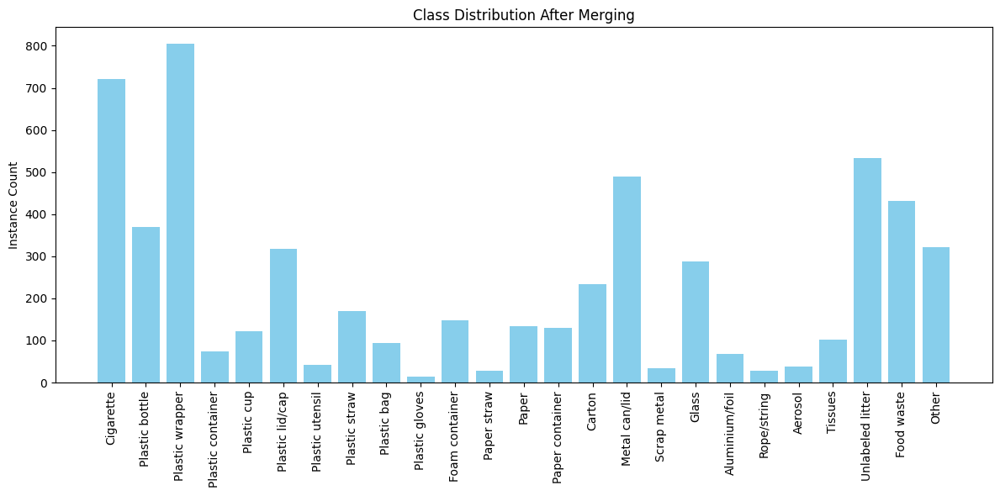

In [23]:
import os
import matplotlib.pyplot as plt
from collections import Counter


label_dir = "/kaggle/working/merged/labels"

# --- Count occurrences ---
class_counter = Counter()

for fname in os.listdir(label_dir):
    if not fname.endswith('.txt'):
        continue

    with open(os.path.join(label_dir, fname), 'r') as f:
        for line in f:
            parts = line.strip().split()
            if not parts:
                continue
            class_id = int(parts[0])
            class_counter[class_id] += 1

# --- Map class IDs to names ---
named_counts = {
    id_to_name[class_id]: count
    for class_id, count in sorted(class_counter.items())
}

# --- Bar plot ---
plt.figure(figsize=(12, 6))
plt.bar(named_counts.keys(), named_counts.values(), color='skyblue')
plt.xticks(rotation=90)
plt.title('Class Distribution After Merging')
plt.ylabel('Instance Count')
plt.tight_layout()
plt.show()

In [24]:
print(named_counts)

{'Cigarette': 722, 'Plastic bottle': 370, 'Plastic wrapper': 804, 'Plastic container': 74, 'Plastic cup': 122, 'Plastic lid/cap': 318, 'Plastic utensil': 42, 'Plastic straw': 170, 'Plastic bag': 94, 'Plastic gloves': 14, 'Foam container': 147, 'Paper straw': 28, 'Paper': 134, 'Paper container': 129, 'Carton': 234, 'Metal can/lid': 489, 'Scrap metal': 34, 'Glass': 288, 'Aluminium/foil': 68, 'Rope/string': 29, 'Aerosol': 38, 'Tissues': 101, 'Unlabeled litter': 534, 'Food waste': 432, 'Other': 322}


In [25]:
tot=0
for x in named_counts.values():
    tot+=x

print(f"Total instances: {tot}")

Total instances: 5737


CLEAN UP

In [26]:
import shutil

to_be_removed = ["/kaggle/working/TACO_extra-1","/kaggle/working/Taco-to-Yolo-Final-1","/kaggle/working/modified_TACO","/kaggle/working/modified_extra"]

for path in to_be_removed:
    shutil.rmtree(path)
    print(path," deleted")

/kaggle/working/TACO_extra-1  deleted
/kaggle/working/Taco-to-Yolo-Final-1  deleted
/kaggle/working/modified_TACO  deleted
/kaggle/working/modified_extra  deleted


RANDOMLY CHECKING ANNOTATIONS ON IMAGES

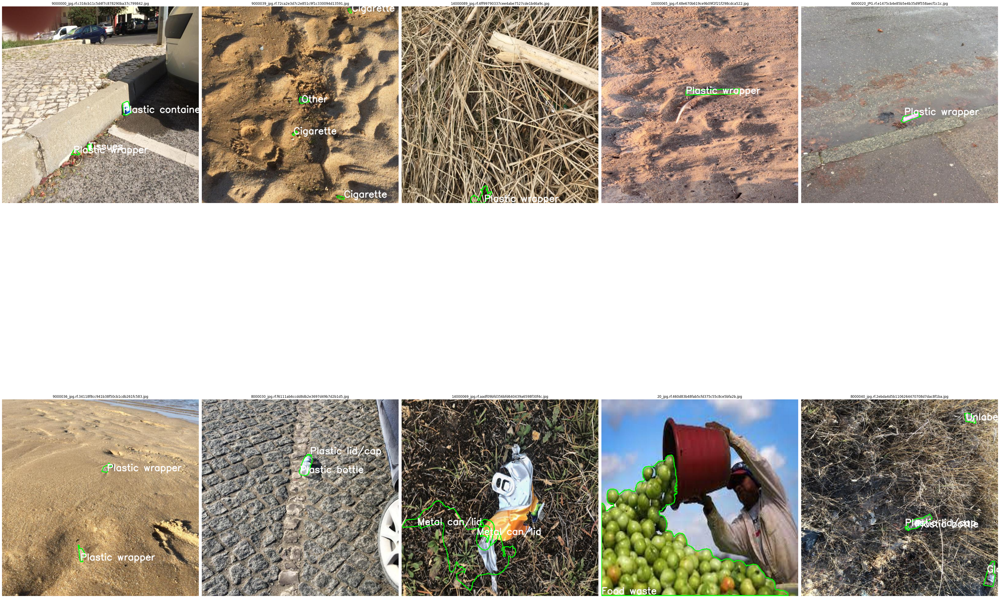

In [27]:
import os
import random
import cv2
import matplotlib.pyplot as plt
import numpy as np

# === Paths ===
image_dir = '/kaggle/working/merged/images'
label_dir = '/kaggle/working/merged/labels'

# === Parameters ===
num_samples = 10

# === Get image-label pairs ===
image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
random.shuffle(image_files)
sampled_files = image_files[:num_samples]

# === Drawing function ===
def draw_polygons_on_image(image_path, label_path):
    image = cv2.imread(image_path)
    if image is None:
        print(f"Could not load image: {image_path}")
        return None
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w = image.shape[:2]

    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) < 3:
                    continue

                class_id = int(parts[0])
                coords = list(map(float, parts[1:]))

                if len(coords) % 2 != 0:
                    continue  # Invalid polygon

                pts = [(int(coords[i] * w), int(coords[i + 1] * h)) for i in range(0, len(coords), 2)]
                pts_np = np.array(pts, np.int32).reshape((-1, 1, 2))

                # Draw polygon outline
                cv2.polylines(image, [pts_np], isClosed=True, color=(0, 255, 0), thickness=2)

                # Put class name at the first point
                label = id_to_name.get(class_id, f"ID {class_id}")
                x, y = pts[0]
                cv2.putText(image, label, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)

    return image

# === Visualize ===
fig, axs = plt.subplots(2, 5, figsize=(50,50))
axs = axs.flatten()

for idx, filename in enumerate(sampled_files):
    image_path = os.path.join(image_dir, filename)
    label_path = os.path.join(label_dir, os.path.splitext(filename)[0] + '.txt')

    result_img = draw_polygons_on_image(image_path, label_path)

    if result_img is not None:
        axs[idx].imshow(result_img)
        axs[idx].set_title(filename)
        axs[idx].axis('off')

plt.tight_layout()
plt.show()

In [28]:
import zipfile
import os

def zip_folder(folder_path, output_path):
    with zipfile.ZipFile(output_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
        for root, dirs, files in os.walk(folder_path):
            for file in files:
                file_path = os.path.join(root, file)
                # Write file to zip with relative path
                arcname = os.path.relpath(file_path, start=folder_path)
                zipf.write(file_path, arcname)

# Example usage
folder_to_compress = '/kaggle/working/merged'
zip_output = 'merged.zip'
zip_folder(folder_to_compress, zip_output)
